In [1]:
import pandas as pd

df = pd.read_csv(".\processed_data1\sentiment.csv")

<>:3: SyntaxWarning: invalid escape sequence '\p'
<>:3: SyntaxWarning: invalid escape sequence '\p'
C:\Users\shaun\AppData\Local\Temp\ipykernel_25844\169277345.py:3: SyntaxWarning: invalid escape sequence '\p'
  df = pd.read_csv(".\processed_data1\sentiment.csv")


In [2]:
# Map sentiment labels from numeric fields
df["true_label"] = df["review_score"].map({1: "positive", 0: "negative"})
df["bert_label"] = df["bert_sentiment"].map({1: "positive", 0: "negative"})
df["vader_label"] = df["vader_sentiment"].apply(
    lambda x: "positive" if x > 0.05 else "negative" if x < -0.05 else "neutral"
)

# Check if predictions are correct
df["bert_correct"] = df["bert_label"] == df["true_label"]
df["vader_correct"] = df["vader_label"] == df["true_label"]

# Show a few random rows for analysis
sample_df = df[[
    "cleaned_review_text", "true_label",
    "bert_label", "bert_sentiment", "bert_correct",
    "vader_label", "vader_sentiment", "vader_correct"
]]

print(sample_df.sample(10))  # or export to Excel if needed


                                      cleaned_review_text true_label  \
96808   damn kwhy first everyone knows story sucks gam...   negative   
61409   best game ever ts god idk keep good work psyonnix   positive   
34847   enjoy soaring majestically right past balls cr...   positive   
137956                               fun competitive game   positive   
2286                                              life lt   positive   
116457  singleplayer amazing multiplayer whack feels l...   positive   
174734  looking see people say free game well amazing ...   positive   
139093                                     n game history   positive   
32646   rocket league piece cancer community makes wan...   negative   
22032   amount hours says dont play solo standard slow...   positive   

       bert_label  bert_sentiment  bert_correct vader_label  vader_sentiment  \
96808    positive               1         False    positive           0.9167   
61409    positive               1          True

In [3]:
from tabulate import tabulate

# Sample of 10 rows
df_sample = df[[
    "cleaned_review_text", "true_label",
    "vader_label", "vader_sentiment", "vader_correct",
    "bert_label", "bert_correct"
]].copy()

# Format boolean columns with checkmarks
df_sample["vader_correct"] = df_sample["vader_correct"].map({True: "✅", False: "❌"})
df_sample["bert_correct"] = df_sample["bert_correct"].map({True: "✅", False: "❌"})

# Truncate review text if too long
df_sample["cleaned_review_text"] = df_sample["cleaned_review_text"].str.slice(0, 45) + "..."

# Print pretty table
print(tabulate(
    df_sample.rename(columns={
        "cleaned_review_text": "Review Snippet",
        "true_label": "True Label",
        "vader_label": "VADER Label",
        "vader_sentiment": "VADER Score",
        "vader_correct": "VADER Correct",
        "bert_label": "BERT Label",
        "bert_correct": "BERT Correct"
    }),
    headers="keys",
    tablefmt="github"
))


|        | Review Snippet                                   | True Label   | VADER Label   |   VADER Score | VADER Correct   | BERT Label   | BERT Correct   |
|--------|--------------------------------------------------|--------------|---------------|---------------|-----------------|--------------|----------------|
|      0 | ruined life...                                   | positive     | negative      |       -0.4767 | ❌              | negative     | ❌             |
|      1 | experience game type review saying things lik... | positive     | positive      |        0.9961 | ✅              | positive     | ✅             |
|      2 | game saved virginity...                          | positive     | positive      |        0.4215 | ✅              | positive     | ✅             |
|      3 | like original games like games dont lag like ... | positive     | positive      |        0.8817 | ✅              | positive     | ✅             |
|      4 | easy learn hard master...                  

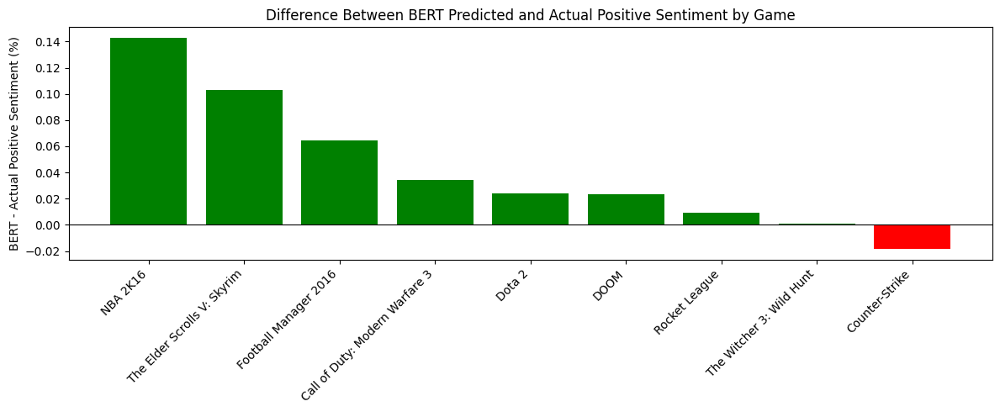

In [4]:
import pandas as pd
import matplotlib.pyplot as plt

# STEP 1: Map review_score to sentiment labels if needed
df["review_label"] = df["review_score"].map({1: "positive", 0: "negative"})
df["bert_label"] = df["bert_sentiment"].map({1: "positive", 0: "negative"})

# STEP 2: Calculate % of positive reviews per game (actual and predicted)
actual_pos = df[df["review_label"] == "positive"].groupby("app_name").size()
bert_pos = df[df["bert_label"] == "positive"].groupby("app_name").size()
total = df.groupby("app_name").size()

# Align and compute %
pct_actual = (actual_pos / total).rename("pct_actual")
pct_bert = (bert_pos / total).rename("pct_bert")

# STEP 3: Merge and compute difference
df_diff = pd.concat([pct_actual, pct_bert], axis=1).dropna()
df_diff["difference"] = df_diff["pct_bert"] - df_diff["pct_actual"]

# STEP 4: Sort by magnitude of difference (optional)
df_diff = df_diff.sort_values("difference", ascending=False)

# STEP 5: Plot
plt.figure(figsize=(12, 5))
bars = plt.bar(df_diff.index, df_diff["difference"], color=["green" if x > 0 else "red" for x in df_diff["difference"]])
plt.axhline(0, color="black", linewidth=0.8)
plt.ylabel("BERT - Actual Positive Sentiment (%)")
plt.title("Difference Between BERT Predicted and Actual Positive Sentiment by Game")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()
